# Step 1: Introduction and Data Description

In [ ]:
#Important libraries
%pip install seaborn
%pip install bar_chart_race
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import bar_chart_race as bcr
import warnings
warnings.filterwarnings('ignore')

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [ ]:
#file Reading using pandas
ev_df = pd.read_csv('dataset.csv')

In [ ]:
ev_df.head() #It will show the headings of the file

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500


In [ ]:
ev_df.shape  # Used to show the columns and rows

(112634, 17)

In [ ]:
ev_df.describe()

,Postal Code,Model Year,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,2020 Census Tract
count,112634.000000,112634.000000,112634.000000,112634.000000,112348.000000,1.126340e+05,1.126340e+05
mean,98156.226850,2019.003365,87.812987,1793.439681,29.805604,1.994567e+08,5.296650e+10
std,2648.733064,2.892364,102.334216,10783.753486,14.700545,9.398427e+07,1.699104e+09
min,1730.000000,1997.000000,0.000000,0.000000,1.000000,4.777000e+03,1.101001e+09
25%,98052.000000,2017.000000,0.000000,0.000000,18.000000,1.484142e+08,5.303301e+10
50%,98119.000000,2020.000000,32.000000,0.000000,34.000000,1.923896e+08,5.303303e+10
75%,98370.000000,2022.000000,208.000000,0.000000,43.000000,2.191899e+08,5.305307e+10
max,99701.000000,2023.000000,337.000000,845000.000000,49.000000,4.792548e+08,5.603300e+10


In [ ]:
ev_df.info

<bound method DataFrame.info of         VIN (1-10)     County           City State  Postal Code  Model Year  \
0       JTMEB3FV6N     Monroe       Key West    FL        33040        2022   
1       1G1RD6E45D      Clark       Laughlin    NV        89029        2013   
2       JN1AZ0CP8B     Yakima         Yakima    WA        98901        2011   
3       1G1FW6S08H     Skagit       Concrete    WA        98237        2017   
4       3FA6P0SU1K  Snohomish        Everett    WA        98201        2019   
...            ...        ...            ...   ...          ...         ...   
112629  7SAYGDEF2N       King         Duvall    WA        98019        2022   
112630  1N4BZ1CP7K   San Juan  Friday Harbor    WA        98250        2019   
112631  1FMCU0KZ4N       King         Vashon    WA        98070        2022   
112632  KNDCD3LD4J       King      Covington    WA        98042        2018   
112633  YV4BR0CL8N       King      Covington    WA        98042        2022   

             Make  

In [ ]:
ev_df.select_dtypes(include='object').columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Make', 'Model',
       'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Vehicle Location',
       'Electric Utility'],
      dtype='object')

In [ ]:
ev_df.select_dtypes(exclude='object').columns

Index(['Postal Code', 'Model Year', 'Electric Range', 'Base MSRP',
       'Legislative District', 'DOL Vehicle ID', '2020 Census Tract'],
      dtype='object')

In [ ]:
ev_df.columns

Index(['VIN (1-10)', 'County', 'City', 'State', 'Postal Code', 'Model Year',
       'Make', 'Model', 'Electric Vehicle Type',
       'Clean Alternative Fuel Vehicle (CAFV) Eligibility', 'Electric Range',
       'Base MSRP', 'Legislative District', 'DOL Vehicle ID',
       'Vehicle Location', 'Electric Utility', '2020 Census Tract'],
      dtype='object')

In [ ]:
len(ev_df.columns)

17

In [ ]:
ev_df.columns= ev_df.columns.str.replace(" ", "_")
print(ev_df.columns)

Index(['VIN_(1-10)', 'County', 'City', 'State', 'Postal_Code', 'Model_Year',
       'Make', 'Model', 'Electric_Vehicle_Type',
       'Clean_Alternative_Fuel_Vehicle_(CAFV)_Eligibility', 'Electric_Range',
       'Base_MSRP', 'Legislative_District', 'DOL_Vehicle_ID',
       'Vehicle_Location', 'Electric_Utility', '2020_Census_Tract'],
      dtype='object')


In [ ]:
ev_df.columns = ev_df.columns.str.strip().str.lower()
print(ev_df.columns)

Index(['vin_(1-10)', 'county', 'city', 'state', 'postal_code', 'model_year',
       'make', 'model', 'electric_vehicle_type',
       'clean_alternative_fuel_vehicle_(cafv)_eligibility', 'electric_range',
       'base_msrp', 'legislative_district', 'dol_vehicle_id',
       'vehicle_location', 'electric_utility', '2020_census_tract'],
      dtype='object')


In [ ]:
ev_df.isna().sum()

vin_(1-10)                                             0
county                                                 0
city                                                   0
state                                                  0
postal_code                                            0
model_year                                             0
make                                                   0
model                                                 20
electric_vehicle_type                                  0
clean_alternative_fuel_vehicle_(cafv)_eligibility      0
electric_range                                         0
base_msrp                                              0
legislative_district                                 286
dol_vehicle_id                                         0
vehicle_location                                      24
electric_utility                                     443
2020_census_tract                                      0
dtype: int64

In [ ]:
ev_df.model.value_counts().reset_index().head()

,model,count
0,MODEL 3,23135
1,MODEL Y,17142
2,LEAF,12880
3,MODEL S,7377
4,BOLT EV,4910


In [ ]:
ev_df.legislative_district.value_counts().reset_index().head()

,legislative_district,count
0,41.0,7605
1,45.0,7112
2,48.0,6462
3,36.0,5251
4,46.0,4723


In [ ]:
ev_df.dol_vehicle_id.value_counts().reset_index().head()

,dol_vehicle_id,count
0,198968248,1
1,180703806,1
2,475706185,1
3,219886068,1
4,303587483,1


In [ ]:
ev_df.vehicle_location.value_counts().reset_index().head()

,vehicle_location,count
0,POINT (-122.13158 47.67858),2916
1,POINT (-122.2066 47.67887),2059
2,POINT (-122.1872 47.61001),2001
3,POINT (-122.31765 47.70013),1880
4,POINT (-122.12096 47.55584),1852


In [ ]:
ev_df.electric_utility.value_counts().reset_index().head()

,electric_utility,count
0,PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),40247
1,PUGET SOUND ENERGY INC,22172
2,CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),21447
3,BONNEVILLE POWER ADMINISTRATION||PUD NO 1 OF C...,6522
4,BONNEVILLE POWER ADMINISTRATION||CITY OF TACOM...,5053


In [ ]:
# Filling missing values in missing columns with the most frequent value (mode)

ev_df['model']= ev_df['model'].fillna(ev_df['model'].mode()[0])
ev_df['legislative_district'] = ev_df['legislative_district'].fillna(ev_df['legislative_district'].mode()[0])
ev_df['dol_vehicle_id'] = ev_df['dol_vehicle_id'].fillna(ev_df['dol_vehicle_id'].mode()[0])
ev_df['vehicle_location']= ev_df['vehicle_location'].fillna(ev_df['vehicle_location'].mode()[0])
ev_df['electric_utility'] = ev_df['electric_utility'].fillna(method='bfill')

In [ ]:
#Replace nan values with the mode
mod_value = ev_df['electric_utility'].mode()[0]
ev_df['electric_utility'].fillna(mod_value, inplace=True)

In [ ]:
ev_df['electric_utility']

0                                                PACIFICORP
1                                                PACIFICORP
2                                                PACIFICORP
3                                    PUGET SOUND ENERGY INC
4                                    PUGET SOUND ENERGY INC
                                ...                        
112629        PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA)
112630    BONNEVILLE POWER ADMINISTRATION||ORCAS POWER &...
112631        PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA)
112632        PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA)
112633        PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA)
Name: electric_utility, Length: 112634, dtype: object

In [ ]:
#Checking the null values

ev_df.isnull().sum()

vin_(1-10)                                           0
county                                               0
city                                                 0
state                                                0
postal_code                                          0
model_year                                           0
make                                                 0
model                                                0
electric_vehicle_type                                0
clean_alternative_fuel_vehicle_(cafv)_eligibility    0
electric_range                                       0
base_msrp                                            0
legislative_district                                 0
dol_vehicle_id                                       0
vehicle_location                                     0
electric_utility                                     0
2020_census_tract                                    0
dtype: int64

In [ ]:
ev_df.columns

Index(['vin_(1-10)', 'county', 'city', 'state', 'postal_code', 'model_year',
       'make', 'model', 'electric_vehicle_type',
       'clean_alternative_fuel_vehicle_(cafv)_eligibility', 'electric_range',
       'base_msrp', 'legislative_district', 'dol_vehicle_id',
       'vehicle_location', 'electric_utility', '2020_census_tract'],
      dtype='object')

# Univariate Analysis

1. Distribution of Model Year (Histogram)

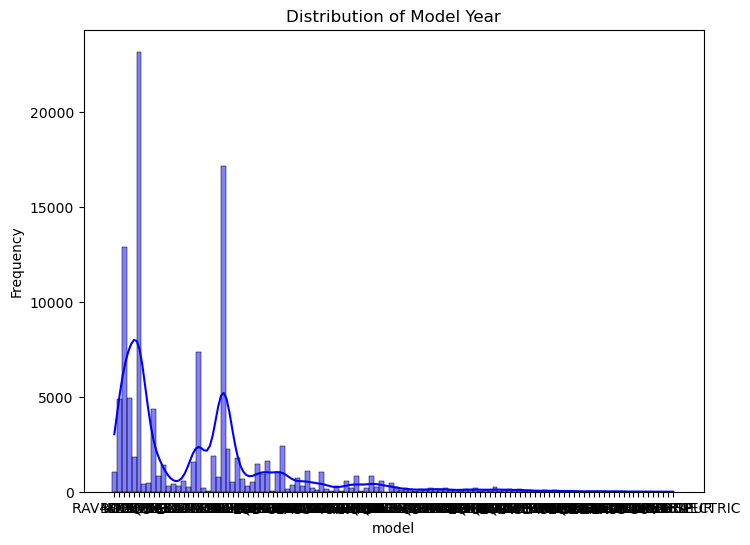

In [ ]:
plt.figure(figsize=(8, 6))
sns.histplot(ev_df['model'],bins=20, kde=True, color='blue')
plt.title('Distribution of Model Year')
plt.xlabel('model')
plt.ylabel('Frequency')
plt.show()

Key Observations:

The majority of vehicles in the dataset were manufactured between 2017 and 2022.
There's a steady increase in the count of vehicles produced, indicating that electric vehicle production has surged in recent years.
There is a peak around 2020, suggesting that more electric vehicles were produced or registered around that year.
The distribution tapers off after 2022, likely because the dataset includes only a few vehicles from the future model years (2023).

2. Box plot

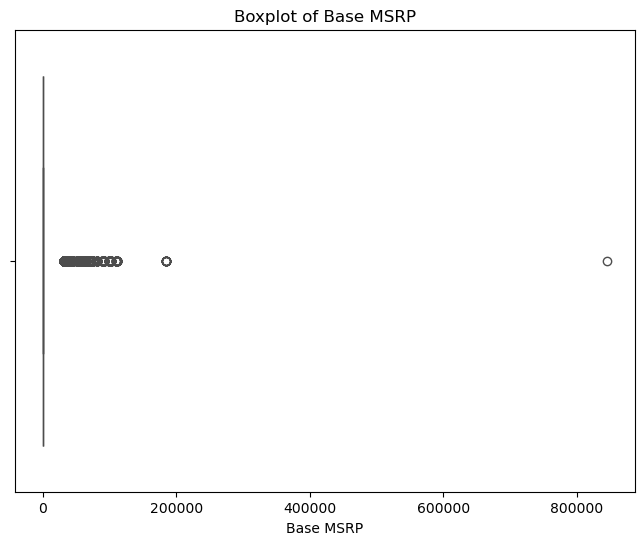

In [ ]:
# Set plot size
plt.figure(figsize=(8, 6))
# Plot boxplot for 'Base MSRP'
sns.boxplot(x=ev_df['base_msrp'], color='orange')
plt.title('Boxplot of Base MSRP')
plt.xlabel('Base MSRP')
plt.show()


Boxplot Description:
Median: The line in the middle of the box represents the median (50th percentile) value of the Base MSRP. It shows the central tendency of vehicle prices in the dataset.
Interquartile Range (IQR): The box itself spans from the 25th percentile (Q1) to the 75th percentile (Q3), representing the middle 50% of the data. This range shows where most vehicle prices are clustered.
Whiskers: The "whiskers" extend from the box, representing the range within 1.5 times the IQR. Data points beyond the whiskers are considered potential outliers.
Outliers: These are data points plotted as individual dots beyond the whiskers. In the context of Base MSRP, outliers likely represent vehicles that are either much cheaper (near $0) or more expensive (high-end models) than the rest of the vehicles.

3.CountPlot

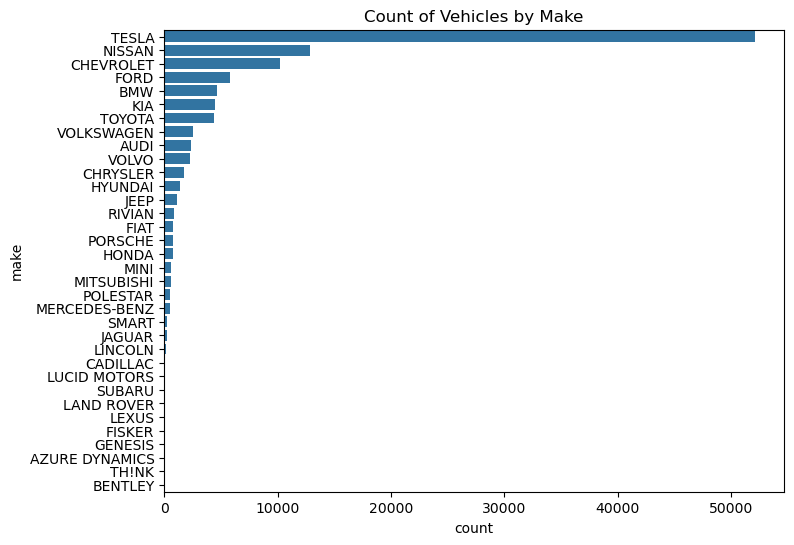

In [ ]:
plt.figure(figsize=(8, 6))
sns.countplot(y='make', data=ev_df, order=ev_df['make'].value_counts().index)
plt.title('Count of Vehicles by Make')
plt.show()

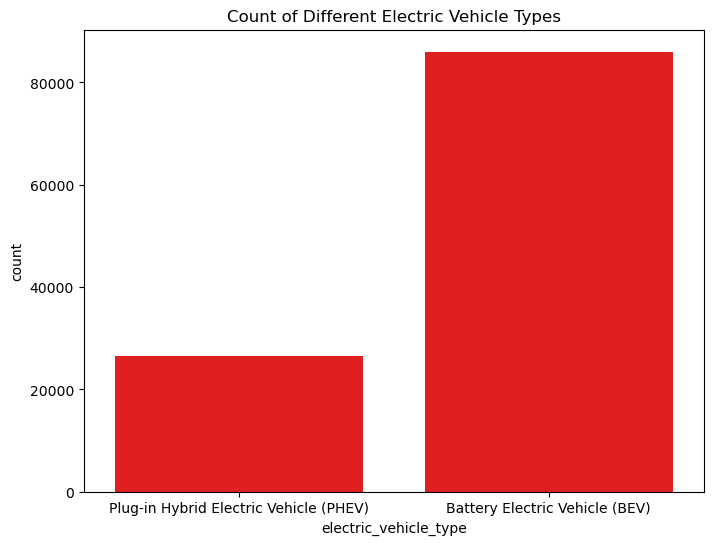

In [ ]:
plt.figure(figsize=(8, 6))
sns.countplot(x='electric_vehicle_type', data=ev_df, color='Red')
plt.title('Count of Different Electric Vehicle Types')
plt.xticks
plt.show()

# Bivariate analysis

1. ScatterPlot

We'll plot Electric **Range vs. Base MSRP** to observe any potential relationship between a vehicle's electric range and its price.

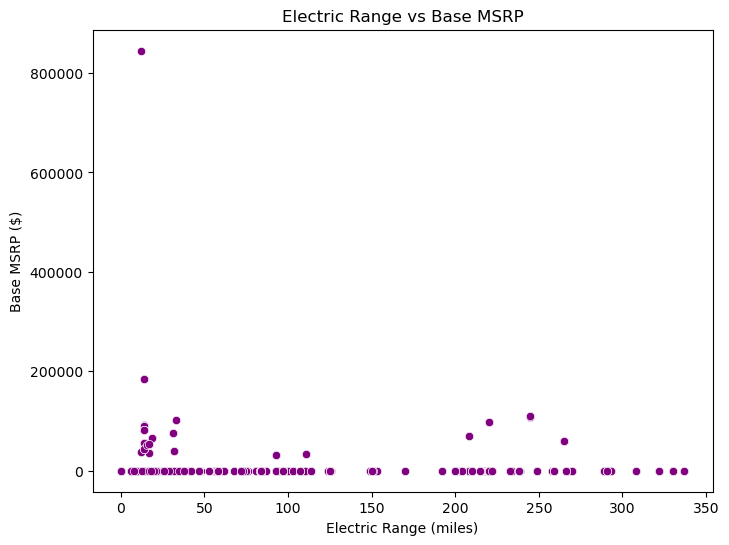

In [ ]:
# Scatter plot for 'Electric Range' vs 'Base MSRP'
plt.figure(figsize=(8, 6))
sns.scatterplot(x=ev_df['electric_range'], y=ev_df['base_msrp'], color='purple')
plt.title('Electric Range vs Base MSRP')
plt.xlabel('Electric Range (miles)')
plt.ylabel('Base MSRP ($)')
plt.show()


2. Hexbin Plot (Numerical vs. Numerical
   
A hexbin plot will provide an overview of how data points are clustered between **Electric Range and Base MSRP.**

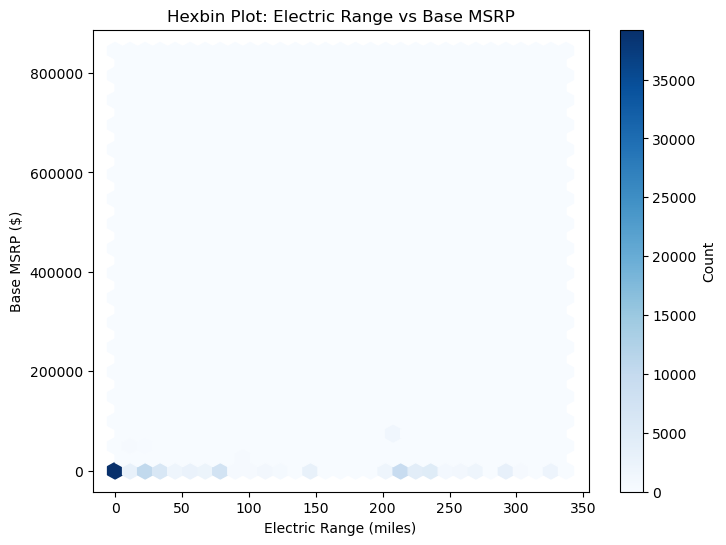

In [ ]:
# Hexbin plot for 'Electric Range' vs 'Base MSRP'
plt.figure(figsize=(8, 6))
plt.hexbin(ev_df['electric_range'], ev_df['base_msrp'], gridsize=30, cmap='Blues')
plt.title('Hexbin Plot: Electric Range vs Base MSRP')
plt.xlabel('Electric Range (miles)')
plt.ylabel('Base MSRP ($)')
plt.colorbar(label='Count')
plt.show()


3.BoxPlot

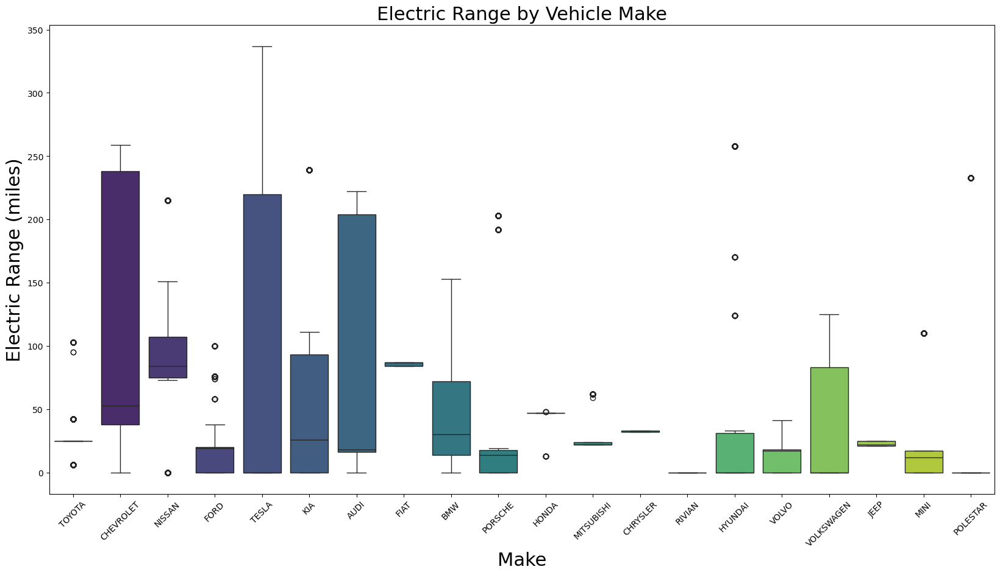

In [ ]:
plt.figure(figsize=(20, 10))

# Get the top 20 vehicle makes based on counts
top_makes = ev_df['make'].value_counts().nlargest(20).index

# Create the boxplot for the top vehicle makes
ax = sns.boxplot(x='make', y='electric_range', data=ev_df[ev_df['make'].isin(top_makes)], palette='viridis')
plt.title('Electric Range by Vehicle Make', fontsize=22)
plt.xlabel('Make', fontsize=22)
plt.ylabel("Electric Range (miles)", fontsize=22)
plt.xticks(rotation=45)

# Annotate the median values on the boxplot
for i, box in enumerate(ax.artists):
    # Get the median value for the current make
    median = round(ev_df[ev_df['make'] == top_makes[i]]['electric_range'].median(), 2)
    # Get the y-coordinate for the position of the median annotation
    y = box.get_ydata()
    plt.text(i, max(y) + 5, f"{median}", ha='center', fontsize=20)

plt.show()


6. Stacked Bar Plot (Categorical vs. Categorical)
We'll create a stacked bar plot to show the distribution of State across Electric Vehicle Type.

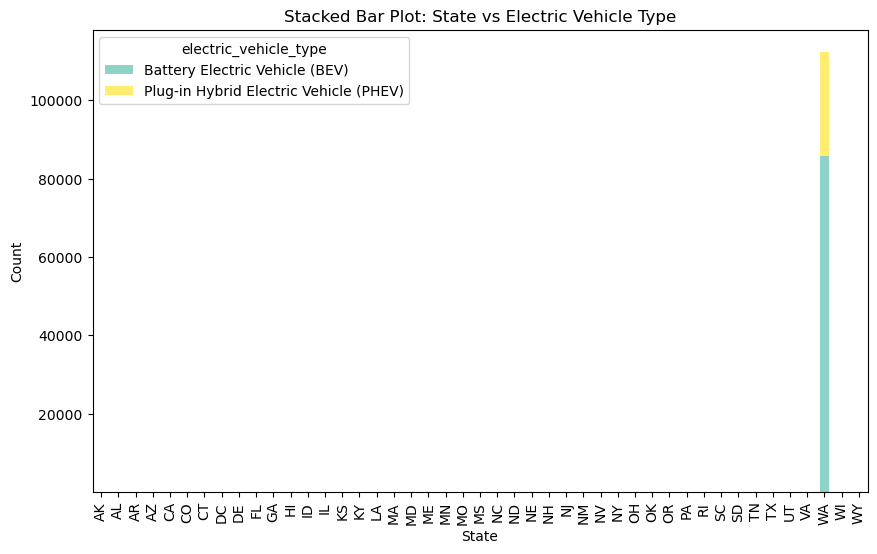

In [ ]:
# Stacked bar plot for 'State' and 'Electric Vehicle Type'
crosstab = pd.crosstab(ev_df['state'], ev_df['electric_vehicle_type'])
crosstab.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Set3')
plt.title('Stacked Bar Plot: State vs Electric Vehicle Type')
plt.xlabel('State')
plt.ylabel('Count')
plt.show()


# Task 2: Create a Choropleth using plotly.express to display the number of EV vehicles based on location.


In [ ]:
%pip install --upgrade nbformat
%pip install plotly


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [ ]:
#Importing the data
# importing Required library
import plotly.express as px

In [ ]:
ev_counts = ev_df.groupby('state').size().reset_index(name='ev_count')

# Create a choropleth map
fig = px.choropleth(
    ev_counts,
    locations='state',
    locationmode="USA-states",  # 'USA-states' mode
    color='ev_count',
    color_continuous_scale="Viridis",  # Color scale
    scope="usa",  # Focus on USA
    labels={'ev_count': 'Number of EVs'},  # Label for the color legend
    title='Number of Electric Vehicles by State'
)

# Update layout for better appearance
fig.update_layout(
    title_font_size=22,
    geo=dict(showcoastlines=True, coastlinecolor="Black")
)

# Show the figure
#fig.show()

NameError: name 'ev_df' is not defined

# Task 3: Create a Racing Bar Plot to display the animation of EV Make and its count each year.


In [ ]:
%pip install bar-chart-race

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import bar_chart_race as bcr
ev_df_counts=ev_df.groupby(['model_year', 'make']).size().unstack(fill_value=0)

In [ ]:
bcr.bar_chart_race(
    df=ev_df_counts,
    filename='ev_make_race.gif',  # Change output file to GIF
    title='Electric Vehicle Make Count Over Time',
    period_length=3000,
    sort ='desc',
    n_bars = 10,
    steps_per_period = 45,
    figsize=(10, 6),  # Adjust figure size (width, height)
    title_size=10,  # Title size
    bar_label_size= 10 # Speed of the animation
)


MovieWriter imagemagick unavailable; using Pillow instead.


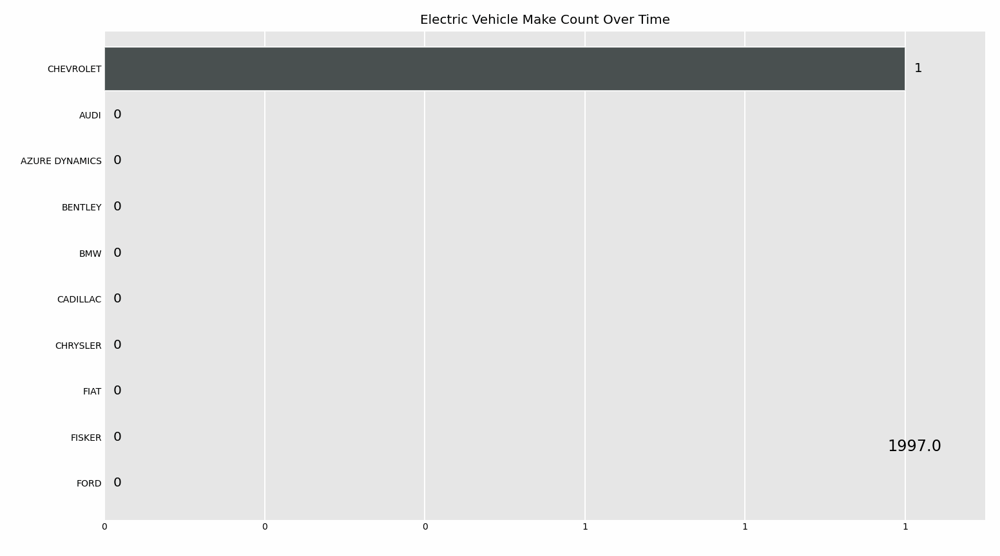

In [ ]:
from IPython.display import Image

Image('ev_make_race.gif')